In [1]:
import tensorflow as tf
import numpy as np
from tensorflow import keras
import matplotlib.pyplot as plt
import my_alg
%matplotlib inline

In [2]:
# define loss function: could also try other loss function like mae ssim
import tensorflow.keras.backend as K

def cross_entropy(y_true, y_pred):
    loss = K.mean(keras.losses.binary_crossentropy(y_true, y_pred), axis=-1)
    return loss

In [3]:
# load dataset: You need to adjust the directory.
mnist_x = np.load(r'C:\Users\Mz406\OneDrive - University of Utah\Senior Project\Images\GndTruth400x400.npy')
mnist_b = np.load(r'C:\Users\Mz406\OneDrive - University of Utah\Senior Project\Images\DiffusedPics800.npy')


In [4]:
# check shape of dataset
mnist_x.shape, mnist_b.shape

((800, 128, 128, 3), (800, 128, 128, 3))

In [5]:
# expand dimension of dataset to fit model
#mnist_b = np.expand_dims( mnist_b, axis=3)
#mnist_x = np.expand_dims( mnist_x, axis=3)

In [6]:
mnist_x.shape, mnist_b.shape

((800, 128, 128, 3), (800, 128, 128, 3))

In [7]:
# define random function to seprate dataset into train data, eval data and test data, randomly
np.random.seed(47)
arg_random = np.random.permutation( len( mnist_b))

In [8]:
# seprate dataset into train data, eval data and test data, randomly
NUM_TRAIN = int( 0.9 * len( mnist_x))
x_train = mnist_x[ arg_random[:NUM_TRAIN-1000]]
b_train = mnist_b[arg_random[:NUM_TRAIN-1000]]

x_eval = mnist_x[ arg_random[NUM_TRAIN-1000:NUM_TRAIN]]
b_eval = mnist_b[ arg_random[NUM_TRAIN-1000:NUM_TRAIN]]

x_test = mnist_x[ arg_random[NUM_TRAIN:]]
b_test = mnist_b[ arg_random[NUM_TRAIN:]]

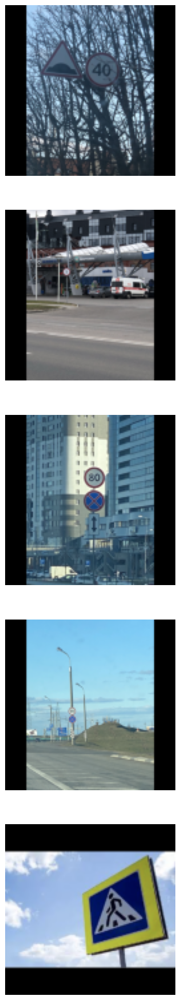

In [9]:
fig = my_alg.show_random_sampels( x_train,5,1,idx = range(5))

In [ ]:
# define model and compile it: learning rate is adjustable
# this is for gray scale images
#model = my_alg.build_model_128()
#model.compile(optimizer=keras.optimizers.Adam(1e-3, amsgrad= True), loss=ave_cross_en, metrics=['mae'])

In [10]:
# define model and compile it: learning rate is adjustable
#this is for color image
model = my_alg.build_model_128_color()
model.compile(optimizer=keras.optimizers.Adam(1e-3, amsgrad= True), loss=cross_entropy, metrics=['mae'])

In [11]:
# train model: set batch_size and epochs
model.fit(b_train, x_train, batch_size=16, epochs=8, verbose=1,validation_data= ( b_eval, x_eval))

Epoch 1/8
33/33 [==============================] - 280s 8s/step - loss: 0.5629 - mae: 0.1637 - val_loss: 0.6520 - val_mae: 0.2530
Epoch 2/8
33/33 [==============================] - 284s 9s/step - loss: 0.4826 - mae: 0.1045 - val_loss: 0.6263 - val_mae: 0.2357
Epoch 3/8
33/33 [==============================] - 284s 9s/step - loss: 0.4633 - mae: 0.0840 - val_loss: 0.6024 - val_mae: 0.2179
Epoch 4/8
33/33 [==============================] - 301s 9s/step - loss: 0.4575 - mae: 0.0787 - val_loss: 0.6018 - val_mae: 0.2177
Epoch 5/8
33/33 [==============================] - 308s 9s/step - loss: 0.4534 - mae: 0.0744 - val_loss: 0.6155 - val_mae: 0.2279
Epoch 6/8
33/33 [==============================] - 344s 10s/step - loss: 0.4512 - mae: 0.0713 - val_loss: 0.5949 - val_mae: 0.2119
Epoch 7/8
33/33 [==============================] - 493s 15s/step - loss: 0.4485 - mae: 0.0672 - val_loss: 0.5931 - val_mae: 0.2093
Epoch 8/8
33/33 [==============================] - 490s 15s/step - loss: 0.4486 - mae: 0

In [12]:
# predict train data
train_pred = model.predict( b_train)

17/17 [==============================] - 160s 9s/step


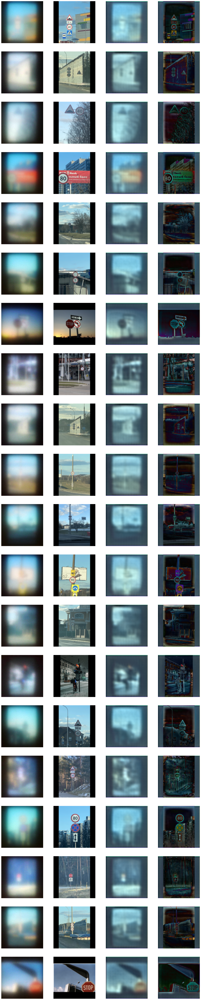

In [13]:
train_fig = my_alg.show_some_results( b_train, x_train, train_pred,20)

In [14]:
# predict test data
test_pred = model.predict( b_test)

3/3 [==============================] - 18s 5s/step


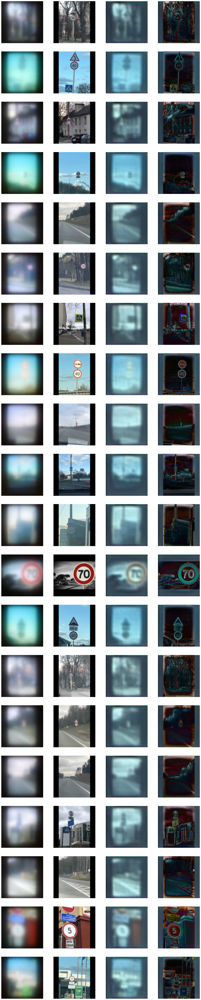

In [15]:
test_fig = my_alg.show_some_results( b_test, x_test, test_pred,20, img_size=5)

In [19]:
#save the image: you need to adjust the directory
test_fig.savefig(r"C:\Users\Mz406\OneDrive - University of Utah\Senior Project\Images\epoch800")

In [ ]:
#save the trained network: you need to adjust the directory
model.save('')

In [ ]:
#load the trained network: you need to adjust the directory
from tensorflow.keras.models import load_model
model = load_model('G:/living_plant/128_e25_b4_filter_change1_ave_cross_en_ssim_1e4', custom_objects = { "ave_cross_en" : ave_cross_en_ssim})